In [1]:
import sys
print(sys.executable)

C:\Users\Artyom\AppData\Local\Programs\Python\Python38\python.exe


In [2]:
!pip install catboost plotly

You should consider upgrading via the 'c:\users\artyom\appdata\local\programs\python\python38\python.exe -m pip install --upgrade pip' command.


In [3]:
!pip install nbformat

You should consider upgrading via the 'c:\users\artyom\appdata\local\programs\python\python38\python.exe -m pip install --upgrade pip' command.


[Данные](https://yadi.sk/d/CBoVCVIxJ2q2cw)

# Обработка лидарных данных
## Сегментация

### Про лидар

![](https://realnoevremya.com/uploads/gallery/b9/7e/35d10da899958110.jpg)

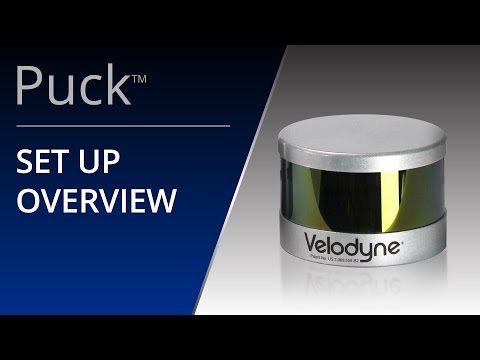

In [4]:
from IPython.lib.display import YouTubeVideo
YouTubeVideo('Pa-q5elS_nE')

## А что за данные на самом деле


In [5]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt

import plotly.offline as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
import tqdm
py.init_notebook_mode(connected=True)

EQUAL_ASPECT_RATIO_LAYOUT = dict(
    margin={
        'l': 0,
        'r': 0,
        'b': 0,
        't': 0
    }, scene=dict(
    aspectmode='data'
))


def color(x, cmap='Reds'):
    cmap = plt.get_cmap(cmap)
    x = (x - np.min(x)) / np.max(x)
    
    return cmap(x)

%matplotlib inline

In [6]:
ds = pd.read_csv('./snow.csv')
ds = ds.set_index(['scene_id'])
ds.head()

,x,y,z,intensity,ring,label
scene_id,,,,,,
0,-11.355618,-4.206962,0.344085,0.0,23.0,1.0
0,-5.916535,-1.972164,0.283262,0.0,25.0,1.0
0,-7.410451,-2.113039,2.137792,0.0,31.0,1.0
0,-13.845870,-1.406652,0.406310,0.0,23.0,1.0
0,-8.326218,-0.346060,0.226469,0.0,22.0,1.0


* intensity - ???
* ring - ???

### Кольцо

![](https://eckop.com/wp-content/uploads/2018/07/LIDAR_02-1024x366.png)

In [7]:
scene = ds.loc[0]

fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(scene.ring, 'tab20'),
    },
    'text': scene.ring
})

py.iplot(fig)


### Интенсивность

![](https://res.mdpi.com/sensors/sensors-15-28099/article_deploy/html/images/sensors-15-28099-g001-1024.png)

In [8]:
fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(scene.intensity, 'seismic'),
    },
    'text': scene.intensity
})

py.iplot(fig)

In [9]:
scene = ds.loc[1]

fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(scene.intensity, 'seismic'),
    },
    'text': scene.ring
})

py.iplot(fig)


# Отфильтруем снег

## Эвристикой

In [10]:
def filter_by_intensity(intensity, limit=3):
    return intensity > limit

filtered_scene = scene[filter_by_intensity(scene.intensity)]


fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': filtered_scene.x,
    'y': filtered_scene.y,
    'z': filtered_scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(filtered_scene.intensity, 'seismic'),
    },
    'text': scene.ring
})

py.iplot(fig)

Плохо и непонятно, будем учить

## Облачные вычисления

In [11]:
import sklearn
from sklearn.neighbors import KDTree
import numpy as np
from numpy.linalg import norm
from scipy.stats import pearsonr

class ComputeFeatures(object):
    def __init__(self, r=1.0):
        self.xyz = None
        self.intensity = None
        self.ring = None
        self.index = None
        self.r = r

    def _feature_names(self):
        return [
            "Count of neighbours",
            "Point intensity",
            "Neighbours intensity",
            "L2 distance",
            "Horizontal distance",
            "Average distance to neighbours",
            "Std of distance to neighbours",
            "Min distance to neighbour",
            "Max distance to neighbour",
            "Number of neighbours on the same ring",
            "Number of distinct neighbours rings",
            "Linearity"  
        ]

        
    def compute_point_features(self, point_id, neighbours):
        neighbours = [i for i in neighbours if i != point_id]
        same_ring_neighbours = [i for i in neighbours if self.ring[i] == self.ring[point_id]]
        distances_to_neighbours = [norm(self.xyz[i] - self.xyz[point_id]) for i in neighbours]
        return [
            len(neighbours),
            self.intensity[point_id],
            np.mean([self.intensity[i] for i in neighbours]) if neighbours else 0,
            norm(self.xyz[point_id]),
            norm(self.xyz[point_id][:2]),
            np.mean(distances_to_neighbours) if neighbours else 0,
            np.std(distances_to_neighbours) if neighbours else 0,
            np.min(distances_to_neighbours) if neighbours else 0,
            np.max(distances_to_neighbours) if neighbours else 0,
            len(same_ring_neighbours),
            len({self.ring[i] for i in neighbours}),
            pearsonr([self.xyz[i][0] for i in same_ring_neighbours + [point_id]], 
                     [self.xyz[i][1] for i in same_ring_neighbours + [point_id]])[0] if same_ring_neighbours else 1
        ]
    
    def get_point_neighbours(self, point_id):
        return self.index.query_radius(self.xyz[point_id][np.newaxis, :], r=self.r)[0]
        
    def __call__(self, xyz, intensity, ring):
        self.xyz = xyz[:]
        self.intensity = intensity[:]
        self.ring = ring[:]
        
        self.index = KDTree(self.xyz)
        
        features = []
        for point_id in range(len(self.xyz)):
            neighbours = self.get_point_neighbours(point_id)
            features.append(self.compute_point_features(point_id, neighbours))
        return pd.DataFrame(columns=self._feature_names(), data=features)
    


In [12]:
# ds_features = pd.read_csv('./snow_features.csv')
# ds_features = ds_features.drop(["Unnamed: 0"], axis=1)
# ds_features.shape

In [13]:
from joblib import Parallel, delayed
import os

def store_features(scene_id, scene):
    features = ComputeFeatures(1.0)
    features_df = features(scene[['x', 'y', 'z']].values, scene.intensity.values, scene.ring.values)
    features_df.to_csv(f'features/{scene_id}.csv')

os.makedirs('features', exist_ok=True)

with Parallel(8) as pool:
    pool(
        delayed(store_features)(scene_id, scene=ds.loc[scene_id])
        for scene_id in tqdm.tqdm(ds.reset_index().scene_id.unique())
    )

100%|████████████████████████████████████████████████████████████████████████████████| 291/291 [20:46<00:00,  4.28s/it]


# Посмотрим на разметку

In [14]:
scene = ds.loc[1]

fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(scene.label, 'seismic'),
    },
    'text': scene.label
})

py.iplot(fig)

## Поучим что-нибудь

In [15]:
import random
data = [(i, pd.read_csv(f'./features/{i}.csv')) for i in ds.reset_index().scene_id.unique()]

In [16]:
def prepare_data(examples):
    features = pd.concat([d for _, d in examples]).drop("Unnamed: 0", axis=1)
    raw_features = pd.concat([ds.loc[scene_id] for scene_id, _ in examples])
    return pd.concat([raw_features.reset_index(), features.reset_index(drop=True)], axis=1)

random.shuffle(data)
train = prepare_data(data[:230])
test = prepare_data(data[230:260])
val = prepare_data(data[260:])

In [17]:
import catboost

def learn(X_train, X_val, y_train, y_val):
    clf = catboost.CatBoostClassifier(n_estimators=100)
    clf.fit(
        X_train, y_train, early_stopping_rounds=10,
        use_best_model=True, eval_set=(X_val.values, y_val.values), plot=True, verbose=False)
    return clf

X_train = train.drop(["scene_id", "label", "x", "y", "z"], axis=1)
y_train = train.label


X_val = val.drop(["scene_id", "label", "x", "y", "z"], axis=1)
y_val = val.label

In [20]:
cls = learn(X_train, X_val, y_train, y_val)


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [23]:
X_test = test.drop(['scene_id', 'x', 'y', 'z', 'label'], axis=1)
y_test = test.label

from sklearn.metrics import precision_recall_curve, precision_score, recall_score

def test_one(clf, X_test, y_test):
    y_test_hat = clf.predict_proba(X_test)
    pr, rec, thr = precision_recall_curve(y_test, y_test_hat[:, 1])
    ix = np.linspace(1, len(pr)-1, num=2000).astype(int)
    return pr[ix], rec[ix], thr[ix - 1]


def heuristic_filter_scoring():
    pr = []
    rec = []
    filter_range = range(1, 10)
    for i in filter_range:
        y_test_heuristic_hat = np.ones(len(X_test))
        y_test_heuristic_hat[filter_by_intensity(test.intensity, i)] = 0
        pr.append(precision_score(y_test, y_test_heuristic_hat))
        rec.append(recall_score(y_test, y_test_heuristic_hat))
        
    return pr, rec, filter_range

pr_bl, rec_bl, thr_bl = heuristic_filter_scoring()

def plot_pr_rec(*models):
    traces = []
    for model, clf, X_test, y_test in models:
        pr, rec, thr = test_one(clf, X_test, y_test)
        pr_rec = go.Scattergl(x = rec, y = pr, mode='lines', text=list(thr), name=model)
        traces.append(pr_rec)

    pr_rec_bl = go.Scatter(x = rec_bl, y = pr_bl, mode='lines+markers', text=list(thr_bl), name='Intensity BL')

    layout = go.Layout(
        title='Precission-recall',
        xaxis=dict(
            title='Recall'
        ),
        yaxis=dict(
            title='Precission'
        ))
    fig = go.Figure(
        data=traces + [pr_rec_bl],
        layout=layout)
    py.iplot(fig)
    
models = [('Catboost classifier', cls, X_test, y_test)]
plot_pr_rec(*models)

# Повизуализируем

In [24]:
y_test_hat = cls.predict_proba(test.drop(['scene_id', 'x', 'y', 'z', 'label'], axis=1))

In [25]:
itest = test.set_index(['scene_id'])

In [29]:
print(test.scene_id.unique())

[238  51  57 237 282  97 288 102 161  21 207  98  23 142 285  72  84 201
 232 156 144   9   0  39 158 134  14  89  79  33]


In [31]:
scene_id = 238
scene = itest.loc[scene_id]
scene_predictions = y_test_hat[test.scene_id == scene_id][:, 1]
scene_labels = np.array(scene.label).astype(np.int)

In [35]:
scene_predictions

array([0.98593616, 0.99555735, 0.9936569 , ..., 0.13219368, 0.13219368,
       0.13397612])

In [36]:
scene_labels

array([1, 1, 1, ..., 0, 0, 0])

In [37]:
def results_colors(prediction, label, threshold):
    if label == 1 and prediction >= threshold:
        return 'green'   # TP
    elif label == 0 and prediction < threshold:
        return 'gray'    # TN
    elif label == 1 and prediction < threshold:
        return 'yellow' # FN
    else:
        return 'red'     # FP  

fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': [results_colors(p, l, 0.5) for p, l in zip(scene_predictions, scene_labels)]
    },
    'text': scene.label
})

py.iplot(fig)